In [178]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
import pandas as pd
import seaborn as sns
from pylab import rcParams
import matplotlib.pyplot as plt
from matplotlib import rc
from sklearn.model_selection import train_test_split
from pandas.plotting import register_matplotlib_converters

%matplotlib inline
%config InlineBackend.figure_format='retina'

register_matplotlib_converters()
sns.set(style='whitegrid', palette='muted', font_scale=1.5)

rcParams['figure.figsize'] = 22, 10

RANDOM_SEED = 42

np.random.seed(RANDOM_SEED)
tf.random.set_seed(RANDOM_SEED)
import warnings
warnings.filterwarnings("ignore")


In [179]:
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf 
from statsmodels.tsa.seasonal import seasonal_decompose      
from pmdarima import auto_arima                              


In [180]:
df=pd.read_csv('Book1.csv',thousands=',')

In [181]:
df

,Date,Price,Open,High,Low,Volume,Chg%
0,"Feb 25, 2022",6848,7210,7220,6777,136.10K,-5.87%
1,"Feb 24, 2022",7275,6940,7617,6940,148.58K,5.76%
2,"Feb 23, 2022",6879,6900,7014,6774,67.95K,-0.55%
3,"Feb 22, 2022",6917,6765,7125,6649,80.37K,0.71%
4,"Feb 21, 2022",6868,6739,6918,6670,53.96K,0.35%
5,"Feb 18, 2022",6844,6824,6938,6669,8.80K,0.04%
6,"Feb 17, 2022",6841,6885,7012,6814,23.81K,-2.92%
7,"Feb 16, 2022",7047,6907,7132,6900,28.73K,2.26%
8,"Feb 15, 2022",6891,7153,7190,6824,55.62K,-3.05%
9,"Feb 14, 2022",7108,6949,7157,6949,56.82K,2.75%


# Data Cleaning

In [182]:
df['Date'] = pd.to_datetime(df['Date']).dt.strftime('%d-%m-%Y')


In [183]:
df['Date'] = pd.to_datetime(df['Date'])

In [184]:
df=df.set_index('Date')

In [185]:
df

,Price,Open,High,Low,Volume,Chg%
Date,,,,,,
2022-02-25,6848,7210,7220,6777,136.10K,-5.87%
2022-02-24,7275,6940,7617,6940,148.58K,5.76%
2022-02-23,6879,6900,7014,6774,67.95K,-0.55%
2022-02-22,6917,6765,7125,6649,80.37K,0.71%
2022-02-21,6868,6739,6918,6670,53.96K,0.35%
2022-02-18,6844,6824,6938,6669,8.80K,0.04%
2022-02-17,6841,6885,7012,6814,23.81K,-2.92%
2022-02-16,7047,6907,7132,6900,28.73K,2.26%
2022-02-15,6891,7153,7190,6824,55.62K,-3.05%


In [186]:
df.index

DatetimeIndex(['2022-02-25', '2022-02-24', '2022-02-23', '2022-02-22',
               '2022-02-21', '2022-02-18', '2022-02-17', '2022-02-16',
               '2022-02-15', '2022-02-14',
               ...
               '2011-12-22', '2011-12-21', '2011-12-20', '2011-12-19',
               '2011-12-17', '2011-12-16', '2011-12-15', '2011-12-14',
               '2011-12-13', '2011-12-12'],
              dtype='datetime64[ns]', name='Date', length=2742, freq=None)

In [187]:
df

,Price,Open,High,Low,Volume,Chg%
Date,,,,,,
2022-02-25,6848,7210,7220,6777,136.10K,-5.87%
2022-02-24,7275,6940,7617,6940,148.58K,5.76%
2022-02-23,6879,6900,7014,6774,67.95K,-0.55%
2022-02-22,6917,6765,7125,6649,80.37K,0.71%
2022-02-21,6868,6739,6918,6670,53.96K,0.35%
2022-02-18,6844,6824,6938,6669,8.80K,0.04%
2022-02-17,6841,6885,7012,6814,23.81K,-2.92%
2022-02-16,7047,6907,7132,6900,28.73K,2.26%
2022-02-15,6891,7153,7190,6824,55.62K,-3.05%


Checking if, in the above data all the dates between Feb 25, 2022 and Dec 12, 2011 are present or not.

In [188]:
pd.date_range(start = '2011-12-15', end = '2011-12-13' ).difference(df.index)

DatetimeIndex([], dtype='datetime64[ns]', freq=None)

In [189]:
df.reindex(pd.date_range('2011-12-15', '2011-12-12')).isnull().all(1)

Series([], Freq: D, dtype: bool)

As clearly seen, our data has all the dates between the above mentioned range.

In [190]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2742 entries, 2022-02-25 to 2011-12-12
Data columns (total 6 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Price   2742 non-null   int64 
 1   Open    2742 non-null   int64 
 2   High    2742 non-null   int64 
 3   Low     2742 non-null   int64 
 4   Volume  2742 non-null   object
 5   Chg%    2742 non-null   object
dtypes: int64(4), object(2)
memory usage: 230.0+ KB


In [191]:
df=df.drop(columns=['Chg%'])

In [192]:
df.columns

Index(['Price', 'Open', 'High', 'Low', 'Volume'], dtype='object')

In [193]:
df['Volume']=df['Volume'].astype(str)

Removing 'K' and '.' from the Volume column

In [194]:
df['Volume'] = df.apply(lambda x: x['Volume'][:-1], axis = 1) 


In [195]:
df['Volume'] = df['Volume'].astype(str)
df['Volume']=pd.to_numeric(df['Volume'])

In [196]:
df['Volume'] = df['Volume']*1000

In [197]:
df=df.dropna()

In [198]:
cols = df.columns
for col in cols:
    df[col]=df[col].astype(int)

In [199]:
df

,Price,Open,High,Low,Volume
Date,,,,,
2022-02-25,6848,7210,7220,6777,136100
2022-02-24,7275,6940,7617,6940,148580
2022-02-23,6879,6900,7014,6774,67950
2022-02-22,6917,6765,7125,6649,80370
2022-02-21,6868,6739,6918,6670,53960
2022-02-18,6844,6824,6938,6669,8800
2022-02-17,6841,6885,7012,6814,23810
2022-02-16,7047,6907,7132,6900,28730
2022-02-15,6891,7153,7190,6824,55620


In [200]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2709 entries, 2022-02-25 to 2011-12-12
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   Price   2709 non-null   int32
 1   Open    2709 non-null   int32
 2   High    2709 non-null   int32
 3   Low     2709 non-null   int32
 4   Volume  2709 non-null   int32
dtypes: int32(5)
memory usage: 74.1 KB


<AxesSubplot:xlabel='Date'>

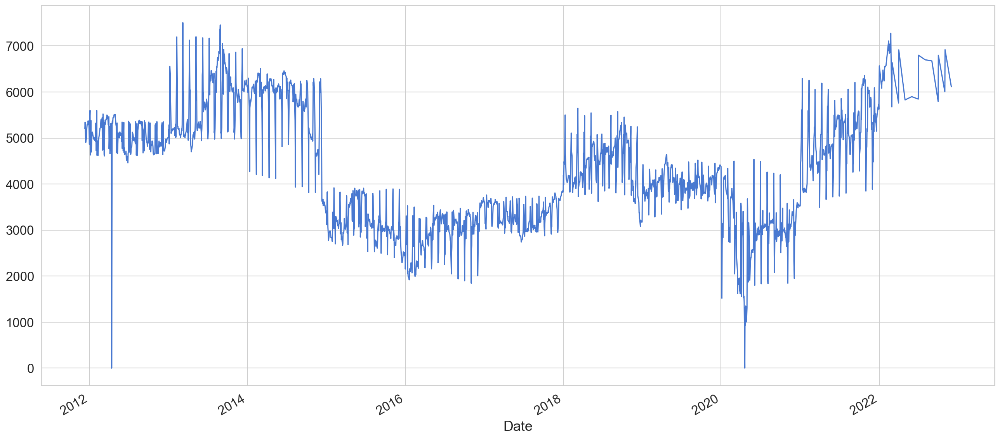

In [201]:
df['Price'].plot()

# Analysis and Pre-processing

In [202]:
df.shape

(2709, 5)

In [203]:
df['year'] = df.index.year
df['day_of_month'] = df.index.day
df['day_of_week'] = df.index.dayofweek
df['month'] = df.index.month

In [204]:
df

,Price,Open,High,Low,Volume,year,day_of_month,day_of_week,month
Date,,,,,,,,,
2022-02-25,6848,7210,7220,6777,136100,2022,25,4,2
2022-02-24,7275,6940,7617,6940,148580,2022,24,3,2
2022-02-23,6879,6900,7014,6774,67950,2022,23,2,2
2022-02-22,6917,6765,7125,6649,80370,2022,22,1,2
2022-02-21,6868,6739,6918,6670,53960,2022,21,0,2
2022-02-18,6844,6824,6938,6669,8800,2022,18,4,2
2022-02-17,6841,6885,7012,6814,23810,2022,17,3,2
2022-02-16,7047,6907,7132,6900,28730,2022,16,2,2
2022-02-15,6891,7153,7190,6824,55620,2022,15,1,2


<AxesSubplot:xlabel='Date', ylabel='Price'>

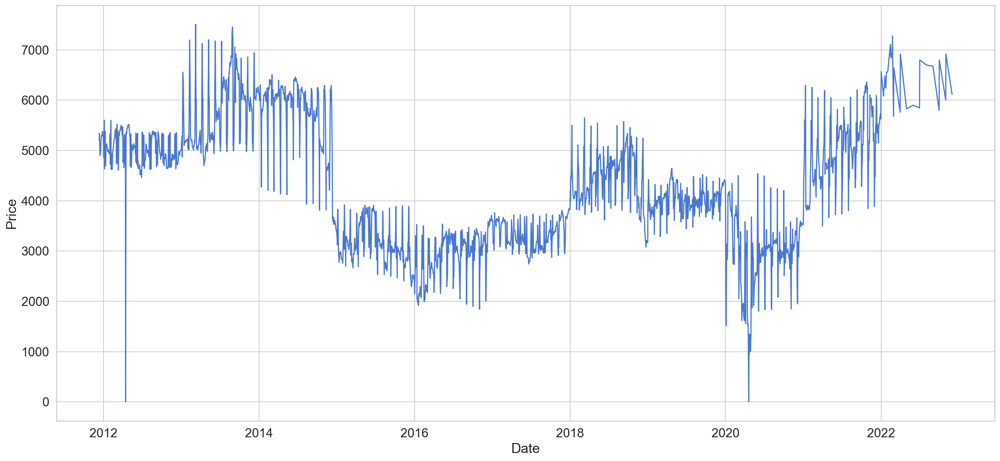

In [205]:
sns.lineplot(x=df.index,y="Price",data=df)

<AxesSubplot:xlabel='year', ylabel='Volume'>

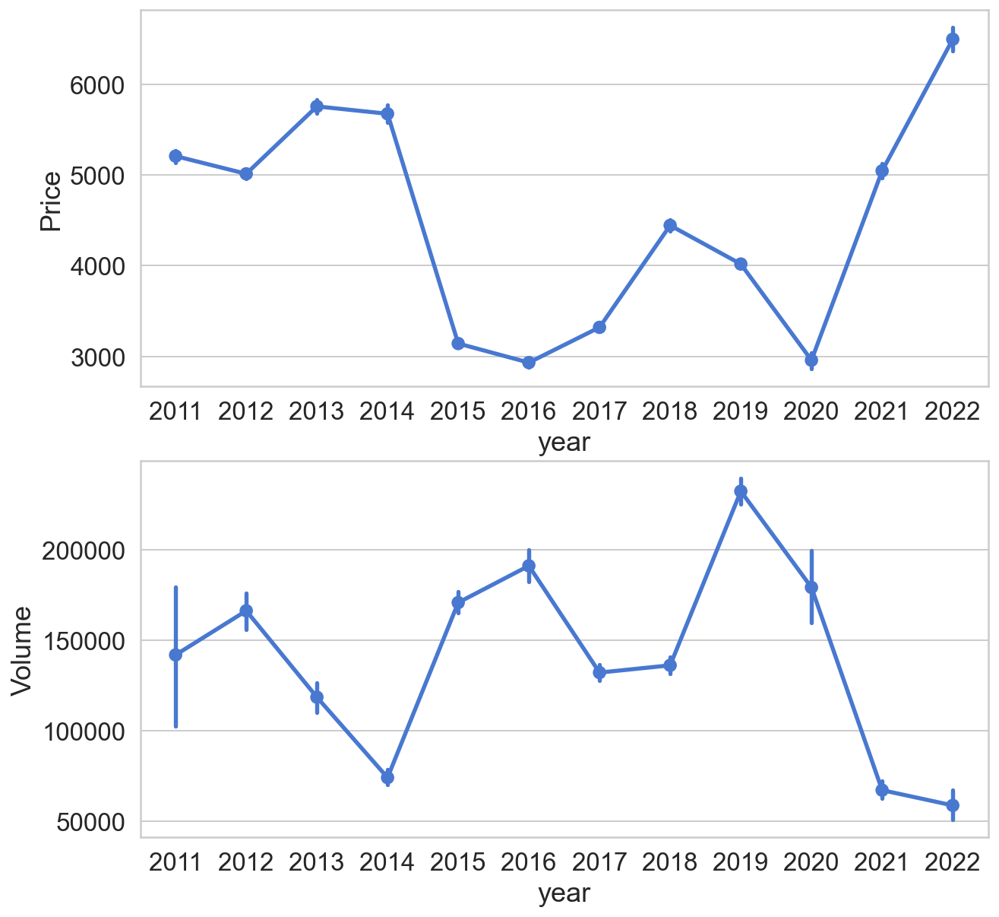

In [206]:
fig,(ax1, ax2)= plt.subplots(nrows=2)
fig.set_size_inches(10, 10)

sns.pointplot(data=df, x='year', y='Price', ax=ax1)
sns.pointplot(data=df, x='year', y='Volume', ax=ax2)


# LSTM Modelling 

In [207]:
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

In [208]:
df.columns

Index(['Price', 'Open', 'High', 'Low', 'Volume', 'year', 'day_of_month',
       'day_of_week', 'month'],
      dtype='object')

In [209]:
train_size = int(len(df) * 0.9)
test_size = len(df) - train_size
train, test = df.iloc[0:train_size], df.iloc[train_size:len(df)]
print(len(train), len(test))

2438 271


In [210]:
feature_cols = ['Open', 'High', 'Low', 'Volume']
feature_transformer = StandardScaler()
price_transformer = StandardScaler()

feature_transformer = feature_transformer.fit(train[feature_cols].to_numpy())
price_transformer = price_transformer.fit(train[['Price']])

train.loc[:, feature_cols] = feature_transformer.transform(train[feature_cols].to_numpy())
train['Price'] = price_transformer.transform(train[['Price']])

test.loc[:, feature_cols] = feature_transformer.transform(test[feature_cols].to_numpy())
test['Price'] = price_transformer.transform(test[['Price']])

In [211]:
def create_dataset(X, y, time_steps=1):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        v = X.iloc[i:(i + time_steps)].values
        Xs.append(v)        
        ys.append(y.iloc[i + time_steps])
    return np.array(Xs), np.array(ys)

In [212]:
time_steps = 10

X_train, y_train = create_dataset(train, train.Price, time_steps)
X_test, y_test = create_dataset(test, test.Price, time_steps)

print(X_train.shape, y_train.shape)

(2428, 10, 9) (2428,)


In [213]:
model = keras.Sequential()
model.add(
    keras.layers.LSTM(128,activation='relu', input_shape=(X_train.shape[1], X_train.shape[2]),return_sequences=True)
)
model.add(
    keras.layers.LSTM(50,activation='relu',return_sequences=False)
)

model.add(keras.layers.Dropout(rate=0.2))
model.add(keras.layers.Dense(units=1))
model.compile(loss='mean_squared_error', optimizer='adam')

In [214]:
history = model.fit(
    X_train, y_train, 
    epochs=25, 
    batch_size=10, 
    validation_split=0.1,
    verbose=1,
    shuffle=True
)

Epoch 1/25
219/219 [==============================] - 5s 11ms/step - loss: 43582.6523 - val_loss: 21.8553
Epoch 2/25
219/219 [==============================] - 2s 10ms/step - loss: 259.0980 - val_loss: 2.7064
Epoch 3/25
219/219 [==============================] - 2s 11ms/step - loss: 101.4543 - val_loss: 5.0249
Epoch 4/25
219/219 [==============================] - 2s 11ms/step - loss: 40.1113 - val_loss: 4.1428
Epoch 5/25
219/219 [==============================] - 2s 10ms/step - loss: 31.3178 - val_loss: 2.7662
Epoch 6/25
219/219 [==============================] - 2s 10ms/step - loss: 25.4493 - val_loss: 4.9744
Epoch 7/25
219/219 [==============================] - 2s 10ms/step - loss: 24.3876 - val_loss: 3.1609
Epoch 8/25
219/219 [==============================] - 2s 10ms/step - loss: 19.7206 - val_loss: 0.6123
Epoch 9/25
219/219 [==============================] - 2s 9ms/step - loss: 17.2330 - val_loss: 2.5818
Epoch 10/25
219/219 [==============================] - 2s 10ms/step - loss: 1

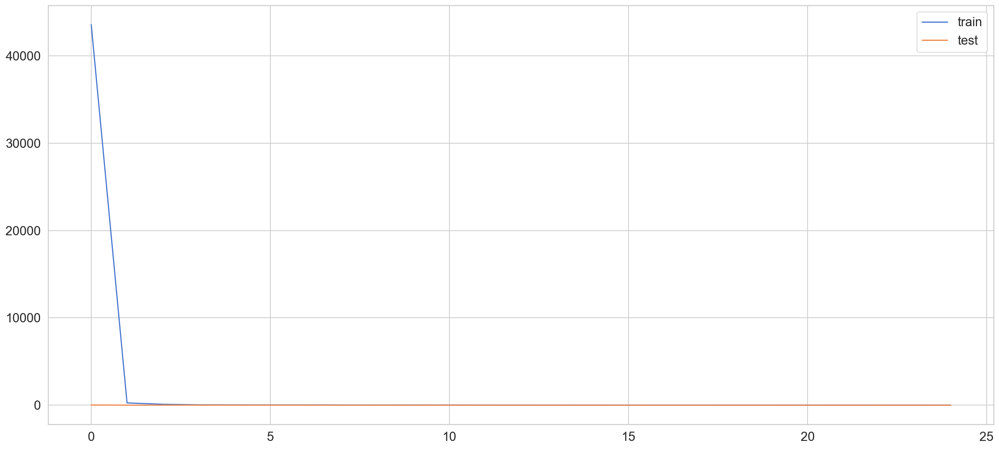

In [215]:
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='test')
plt.legend();

In [216]:
y_pred = model.predict(X_test)

In [217]:
y_train_inv = price_transformer.inverse_transform(y_train.reshape(1, -1))
y_test_inv = price_transformer.inverse_transform(y_test.reshape(1, -1))
y_pred_inv = price_transformer.inverse_transform(y_pred)

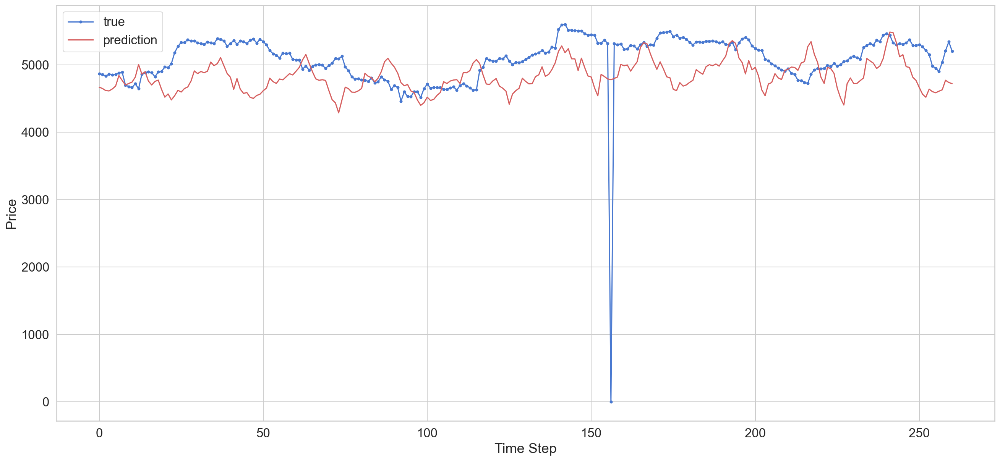

In [218]:
plt.plot(y_test_inv.flatten(), marker='.', label="true")
plt.plot(y_pred_inv.flatten(), 'r', label="prediction")
plt.ylabel('Price')
plt.xlabel('Time Step')
plt.legend()
plt.show();

In [219]:
from sklearn.metrics import mean_absolute_error as mae
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import r2_score as r2s
from numpy import sqrt 

In [220]:
mae1=mae(y_test_inv.reshape(-1,1),y_pred_inv)
mse1=mse(y_test_inv.reshape(-1,1),y_pred_inv)
rmse1=sqrt(mse1)

In [221]:
mae1,rmse1,mse1

(352.1586053490182, 492.4970562611148, 242553.35042586364)

In [222]:
np.mean(y_test_inv)

5080.567049808429

In [223]:
df

,Price,Open,High,Low,Volume,year,day_of_month,day_of_week,month
Date,,,,,,,,,
2022-02-25,6848,7210,7220,6777,136100,2022,25,4,2
2022-02-24,7275,6940,7617,6940,148580,2022,24,3,2
2022-02-23,6879,6900,7014,6774,67950,2022,23,2,2
2022-02-22,6917,6765,7125,6649,80370,2022,22,1,2
2022-02-21,6868,6739,6918,6670,53960,2022,21,0,2
2022-02-18,6844,6824,6938,6669,8800,2022,18,4,2
2022-02-17,6841,6885,7012,6814,23810,2022,17,3,2
2022-02-16,7047,6907,7132,6900,28730,2022,16,2,2
2022-02-15,6891,7153,7190,6824,55620,2022,15,1,2


# Considering the whole dataframe for training and forecasting

In [224]:
import numpy as np
from keras.models import Sequential
from keras.layers import LSTM
from keras.layers import Dropout
from keras.layers import Dense
import pandas as pd
from matplotlib import pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_absolute_error as mae
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import r2_score as r2s
from math import sqrt
import os

In [225]:
dfOil=df
dfOilPrice=dfOil['Price'].astype(float)

In [226]:
scaler=StandardScaler()
scaler=scaler.fit(dfOilPrice.values.reshape(-1, 1))
dfOilPriceScaled=scaler.transform(dfOilPrice.values.reshape(-1, 1))

In [227]:
oilPX=[]
oilPY=[]

In [228]:
nextPrd=1
windSz=14

for i in range(windSz, len(dfOilPriceScaled)-nextPrd+1):    
    oilPX.append(dfOilPriceScaled[i-windSz:i])
    oilPY.append(dfOilPriceScaled[i+nextPrd-1:i+nextPrd,0])

oilPX,oilPY=np.array(oilPX),np.array(oilPY)

In [229]:
print('dfOil shape= {}.'.format(dfOil.shape))
print('dfOilPriceScaled shape= {}.'.format(dfOilPriceScaled.shape))
print('oilPX shape== {}.'.format(oilPX.shape))
print('oilPY shape== {}.'.format(oilPY.shape))

dfOil shape= (2709, 9).
dfOilPriceScaled shape= (2709, 1).
oilPX shape== (2695, 14, 1).
oilPY shape== (2695, 1).


In [230]:
model=Sequential()
model.add(LSTM(100, activation='relu', input_shape=(oilPX.shape[1], oilPX.shape[2]), return_sequences=True))
model.add(LSTM(50, activation= 'relu',return_sequences=False))
model.add(Dropout(0.2))
model.add(Dense(oilPY.shape[1]))
model.compile(optimizer='adam',loss='mse')
history=model.fit(oilPX,oilPY,epochs=25,batch_size=16, validation_split=0.1,verbose=1)

Epoch 1/25
152/152 [==============================] - 4s 14ms/step - loss: 0.1242 - val_loss: 0.0886
Epoch 2/25
152/152 [==============================] - 2s 12ms/step - loss: 0.0451 - val_loss: 0.0871
Epoch 3/25
152/152 [==============================] - 2s 12ms/step - loss: 0.0383 - val_loss: 0.0935
Epoch 4/25
152/152 [==============================] - 2s 12ms/step - loss: 0.0349 - val_loss: 0.0881
Epoch 5/25
152/152 [==============================] - 2s 12ms/step - loss: 0.0316 - val_loss: 0.0908
Epoch 6/25
152/152 [==============================] - 2s 12ms/step - loss: 0.0313 - val_loss: 0.0885
Epoch 7/25
152/152 [==============================] - 2s 12ms/step - loss: 0.0310 - val_loss: 0.0871
Epoch 8/25
152/152 [==============================] - 2s 12ms/step - loss: 0.0300 - val_loss: 0.0879
Epoch 9/25
152/152 [==============================] - 2s 12ms/step - loss: 0.0298 - val_loss: 0.0878
Epoch 10/25
152/152 [==============================] - 2s 12ms/step - loss: 0.0290 - val_lo

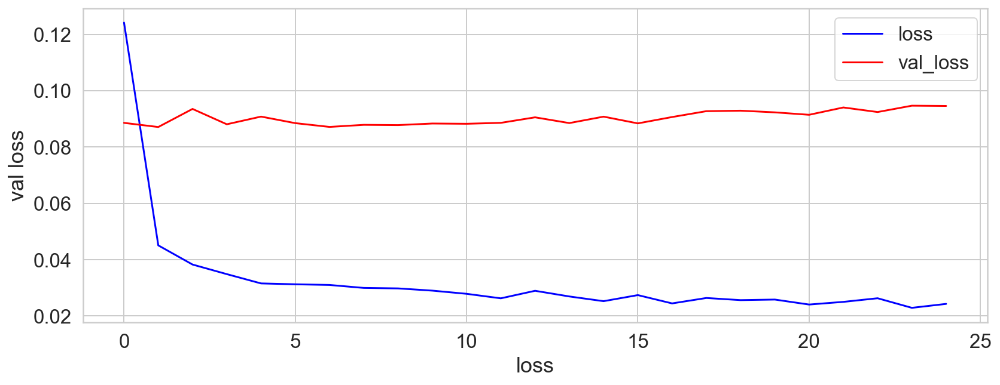

In [231]:
fig, ax = plt.subplots(figsize=(15, 5))
fig.subplots_adjust(bottom=0.15, left=0.2)
ax.plot(range(0,len(history.history['loss'])),history.history['loss'],color='blue',label='loss')
ax.plot(range(0,len(history.history['val_loss'])),history.history['val_loss'],color='red',label='val_loss')
ax.set_xlabel('loss')
ax.set_ylabel('val loss')
plt.legend()
plt.show()

In [232]:
forecastD=60

predictedForDays=model.predict(oilPX[-forecastD:])
actualOilPForDays=dfOil['Price'][-forecastD:]
predictedForDaysInn=scaler.inverse_transform(predictedForDays)

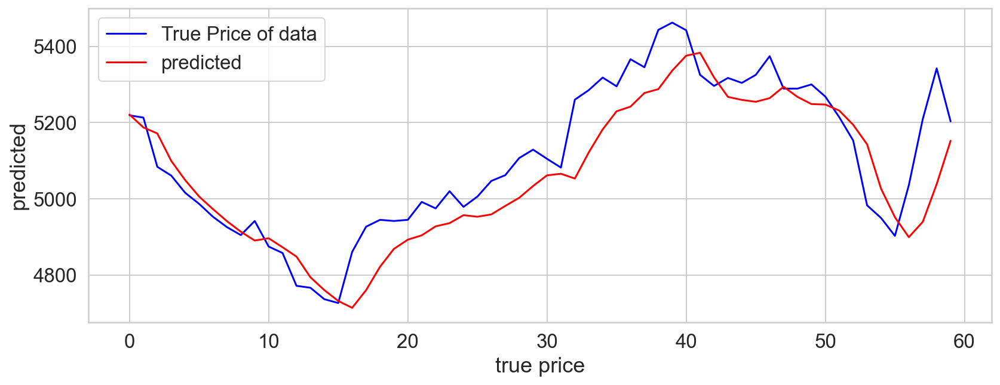

In [233]:
fig, ax = plt.subplots(figsize=(15, 5))
fig.subplots_adjust(bottom=0.15, left=0.2)
ax.plot(range(0,len(predictedForDaysInn)),dfOil['Price'][-forecastD:],color='blue',label='True Price of data')
ax.plot(range(0,len(predictedForDaysInn)),predictedForDaysInn,color='red',label='predicted')
ax.set_xlabel('true price')
ax.set_ylabel('predicted')
plt.legend()
plt.show()

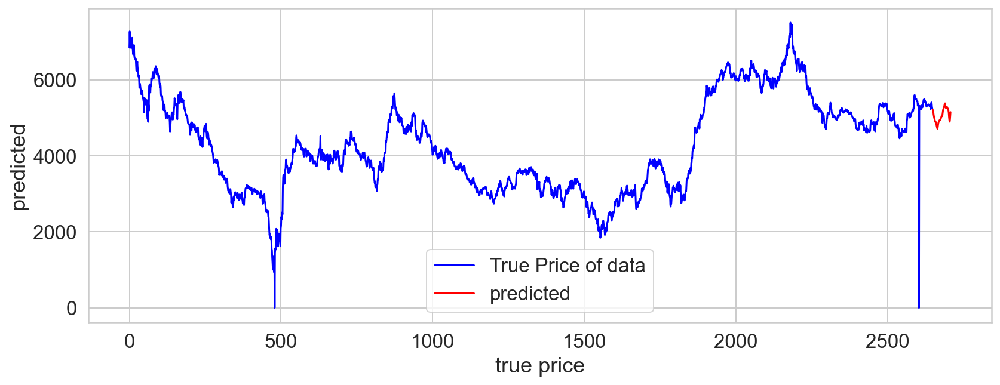

In [234]:
fig, ax = plt.subplots(figsize=(15, 5))
fig.subplots_adjust(bottom=0.15, left=0.2)
ax.plot(range(0,len(dfOil)-forecastD),dfOil['Price'][0:len(dfOil)-forecastD],color='blue',label='True Price of data')
ax.plot(range(len(dfOil)-forecastD,len(dfOil)),predictedForDaysInn,color='red',label='predicted')
ax.set_xlabel('true price')
ax.set_ylabel('predicted')
plt.legend()
plt.show()

In [235]:
mae1=mae(actualOilPForDays,predictedForDaysInn)
mse1=mse(actualOilPForDays,predictedForDaysInn)
print(mse1)
rmse1=sqrt(mse1)
r2_score=r2s(actualOilPForDays,predictedForDaysInn)
print(r2_score)
n=forecastD
k=1
adjr=1-(((1-r2_score)*(n-1))/(n-k-1))
print(adjr)

9307.512559910616
0.7509149815060313
0.7466204122216525


# Statistical Analysis

In [236]:
df

,Price,Open,High,Low,Volume,year,day_of_month,day_of_week,month
Date,,,,,,,,,
2022-02-25,6848,7210,7220,6777,136100,2022,25,4,2
2022-02-24,7275,6940,7617,6940,148580,2022,24,3,2
2022-02-23,6879,6900,7014,6774,67950,2022,23,2,2
2022-02-22,6917,6765,7125,6649,80370,2022,22,1,2
2022-02-21,6868,6739,6918,6670,53960,2022,21,0,2
2022-02-18,6844,6824,6938,6669,8800,2022,18,4,2
2022-02-17,6841,6885,7012,6814,23810,2022,17,3,2
2022-02-16,7047,6907,7132,6900,28730,2022,16,2,2
2022-02-15,6891,7153,7190,6824,55620,2022,15,1,2


In [237]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2709 entries, 2022-02-25 to 2011-12-12
Data columns (total 9 columns):
 #   Column        Non-Null Count  Dtype
---  ------        --------------  -----
 0   Price         2709 non-null   int32
 1   Open          2709 non-null   int32
 2   High          2709 non-null   int32
 3   Low           2709 non-null   int32
 4   Volume        2709 non-null   int32
 5   year          2709 non-null   int64
 6   day_of_month  2709 non-null   int64
 7   day_of_week   2709 non-null   int64
 8   month         2709 non-null   int64
dtypes: int32(5), int64(4)
memory usage: 158.7 KB


<AxesSubplot:title={'center':'Yearly average oil prices'}, xlabel='Date'>

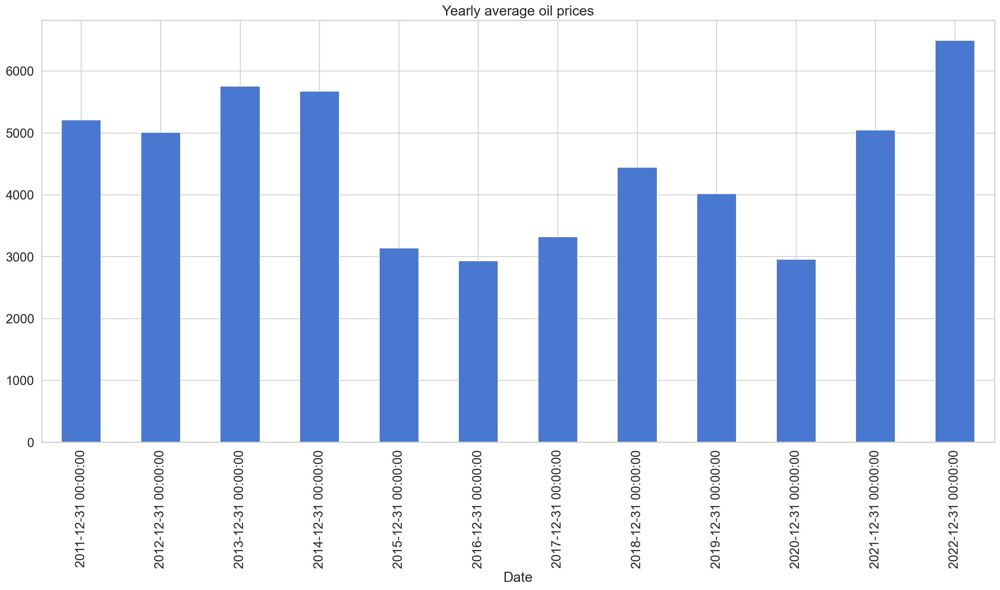

In [238]:
df['Price'].resample('Y').mean().plot.bar(title='Yearly average oil prices')

Date
2011-12-31    AxesSubplot(0.125,0.2;0.775x0.68)
2012-12-31    AxesSubplot(0.125,0.2;0.775x0.68)
2013-12-31    AxesSubplot(0.125,0.2;0.775x0.68)
2014-12-31    AxesSubplot(0.125,0.2;0.775x0.68)
2015-12-31    AxesSubplot(0.125,0.2;0.775x0.68)
2016-12-31    AxesSubplot(0.125,0.2;0.775x0.68)
2017-12-31    AxesSubplot(0.125,0.2;0.775x0.68)
2018-12-31    AxesSubplot(0.125,0.2;0.775x0.68)
2019-12-31    AxesSubplot(0.125,0.2;0.775x0.68)
2020-12-31    AxesSubplot(0.125,0.2;0.775x0.68)
2021-12-31    AxesSubplot(0.125,0.2;0.775x0.68)
2022-12-31    AxesSubplot(0.125,0.2;0.775x0.68)
Freq: A-DEC, Name: Price, dtype: object

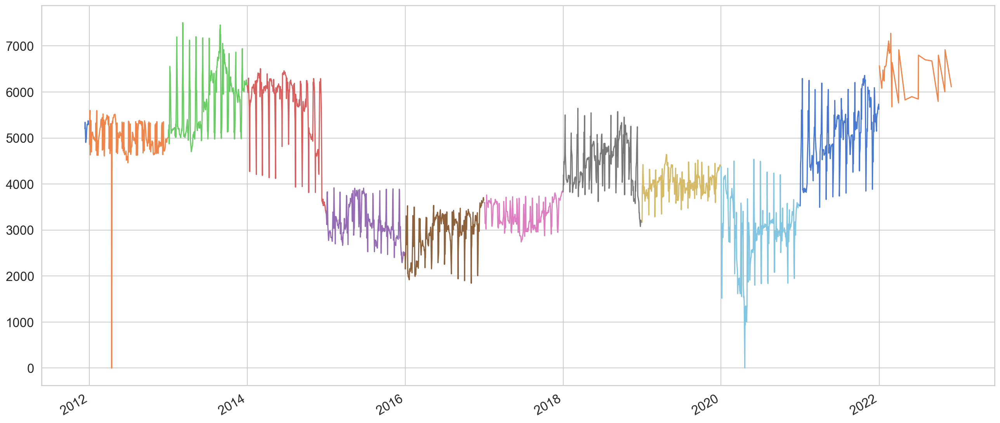

In [239]:
df['Price'].resample('Y').plot()

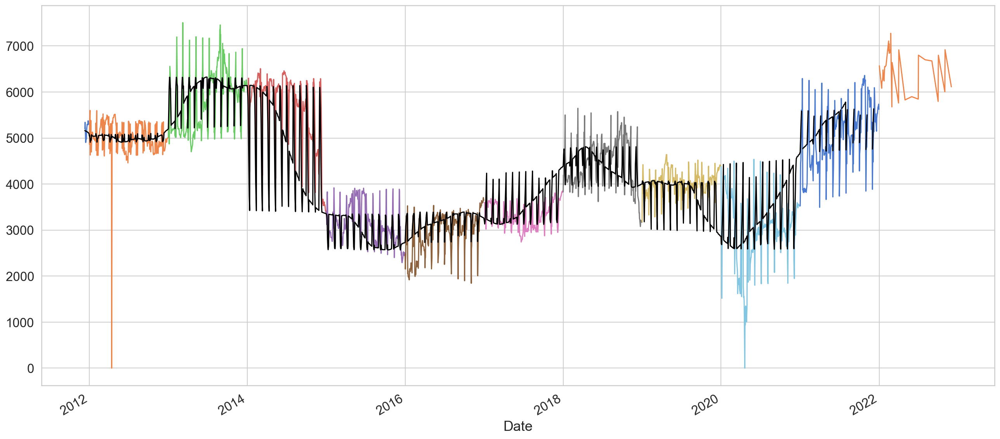

In [240]:
df['Price'].resample('Y').plot()
df.rolling(window=150).mean()['Price'].plot(color='black');

Along the black line, we have found the rolling mean of 150 days, so as to generalise the trend of oil prices.

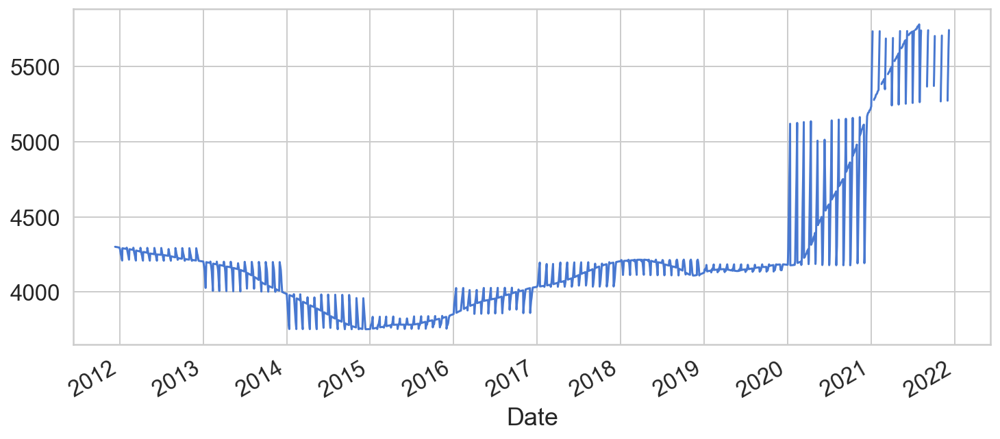

In [241]:
df['Price'].expanding(min_periods=150).mean().plot(figsize=(12,5));

Expanding upon the data and finding average trends of continuous 150 days.

ETS Decompoition

We apply an additive model when it seems that the trend is more linear and the seasonality and trend components seem to be constant over time. A multiplicative model is more appropriate when we are increasing (or decreasing) at a non-linear rate.

In [242]:
df[df<5]=1

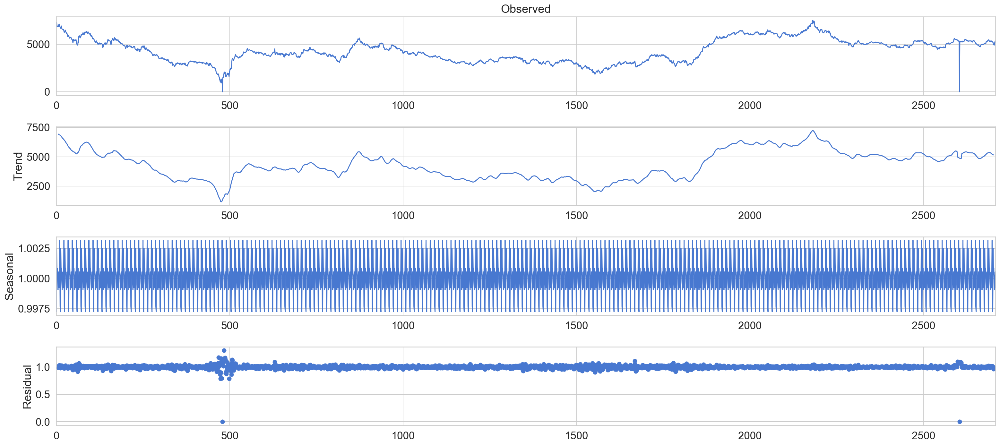

In [243]:
from statsmodels.tsa.seasonal import seasonal_decompose

result = seasonal_decompose(df['Price'].values, model='multiplicative',period=12)  # model='mul' also works
result.plot();

We can see a strong seasonal component 

Simple Moving Average (SMA)

In [244]:
df['6-month-SMA'] = df['Price'].rolling(window=6).mean()
df['12-month-SMA'] = df['Price'].rolling(window=12).mean()

<AxesSubplot:xlabel='Date'>

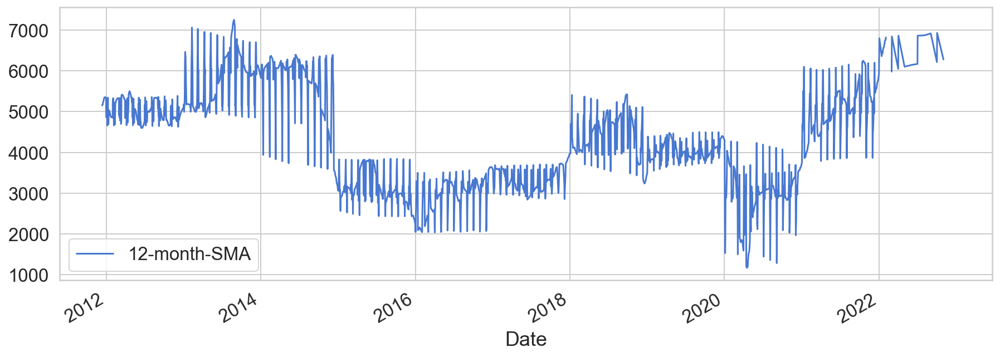

In [245]:

df['12-month-SMA'].plot(figsize=(15,5),legend=True)

We just showed how to calculate the SMA based on some window. However, basic SMA has some weaknesses:

Smaller windows will lead to more noise, rather than signal
It will always lag by the size of the window
It will never reach to full peak or valley of the data due to the averaging.
Does not really inform you about possible future behavior, all it really does is describe trends in your data.
Extreme historical values can skew your SMA significantly

EWMA will allow us to reduce the lag effect from SMA and it will put more weight on values that occured more recently (by applying more weight to the more recent values, thus the name). The amount of weight applied to the most recent values will depend on the actual parameters used in the EWMA and the number of periods given a window size. 

In [246]:
df['EWMA12']=df['Price'].ewm(span=12,adjust=True).mean()

<AxesSubplot:xlabel='Date'>

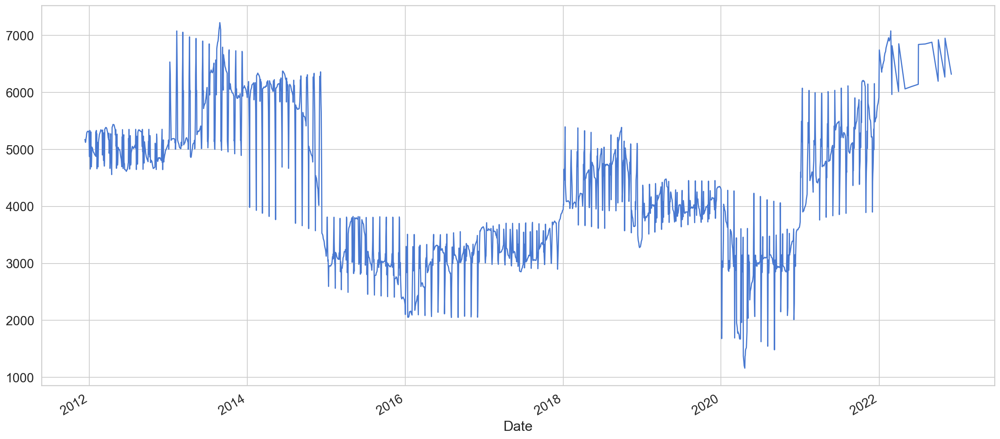

In [247]:
df['EWMA12'].plot()

In [248]:
from statsmodels.tsa.holtwinters import ExponentialSmoothing

In [249]:
df['TESadd12'] = ExponentialSmoothing(df['Price'],trend='add',seasonal='add',seasonal_periods=12).fit().fittedvalues


In [250]:
df['TESmul12'] = ExponentialSmoothing(df['Price'],trend='mul',seasonal='mul',seasonal_periods=12).fit().fittedvalues


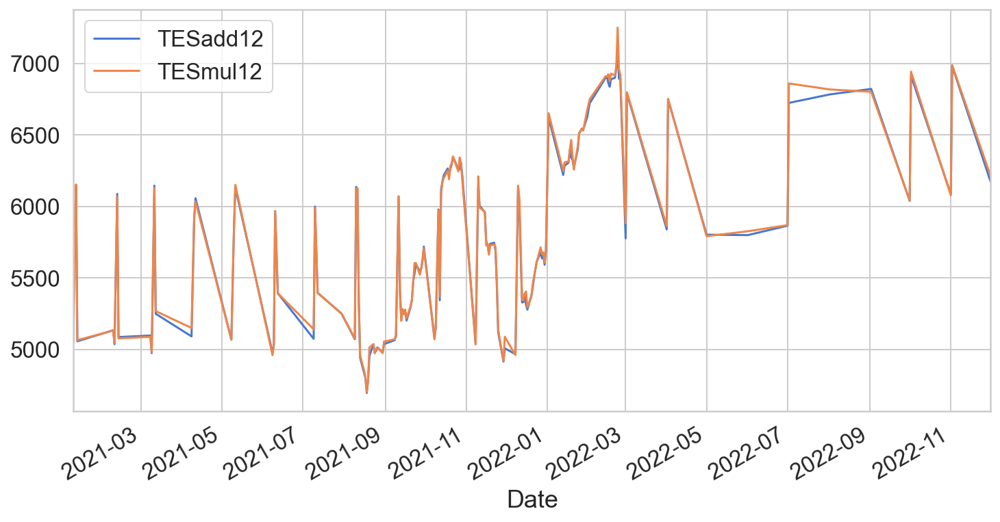

In [251]:
df[['TESadd12','TESmul12']].iloc[:150].plot(figsize=(12,6)).autoscale(axis='x',tight=True);

In [252]:
df

,Price,Open,High,Low,Volume,year,day_of_month,day_of_week,month,6-month-SMA,12-month-SMA,EWMA12,TESadd12,TESmul12
Date,,,,,,,,,,,,,,
2022-02-25,6848,7210,7220,6777,136100,2022,25,1,1,NaN,NaN,6848.000000,6897.985164,6918.669198
2022-02-24,7275,6940,7617,6940,148580,2022,24,1,1,NaN,NaN,7079.291667,6891.904876,6958.188920
2022-02-23,6879,6900,7014,6774,67950,2022,23,1,1,NaN,NaN,7001.117783,7086.116399,7249.633092
2022-02-22,6917,6765,7125,6649,80370,2022,22,1,1,NaN,NaN,6974.565086,6967.841404,6981.650006
2022-02-21,6868,6739,6918,6670,53960,2022,21,1,1,NaN,NaN,6945.611733,6898.585177,6915.271218
2022-02-18,6844,6824,6938,6669,8800,2022,18,1,1,6938.500000,NaN,6920.914736,6888.693281,6927.686017
2022-02-17,6841,6885,7012,6814,23810,2022,17,1,1,6937.333333,NaN,6903.082042,6836.071827,6876.941791
2022-02-16,7047,6907,7132,6900,28730,2022,16,1,1,6899.333333,NaN,6933.115502,6860.675257,6922.888944
2022-02-15,6891,7153,7190,6824,55620,2022,15,1,1,6901.333333,NaN,6924.783557,6909.779710,6906.201701


In [253]:
df2=df

In [254]:
df2

,Price,Open,High,Low,Volume,year,day_of_month,day_of_week,month,6-month-SMA,12-month-SMA,EWMA12,TESadd12,TESmul12
Date,,,,,,,,,,,,,,
2022-02-25,6848,7210,7220,6777,136100,2022,25,1,1,NaN,NaN,6848.000000,6897.985164,6918.669198
2022-02-24,7275,6940,7617,6940,148580,2022,24,1,1,NaN,NaN,7079.291667,6891.904876,6958.188920
2022-02-23,6879,6900,7014,6774,67950,2022,23,1,1,NaN,NaN,7001.117783,7086.116399,7249.633092
2022-02-22,6917,6765,7125,6649,80370,2022,22,1,1,NaN,NaN,6974.565086,6967.841404,6981.650006
2022-02-21,6868,6739,6918,6670,53960,2022,21,1,1,NaN,NaN,6945.611733,6898.585177,6915.271218
2022-02-18,6844,6824,6938,6669,8800,2022,18,1,1,6938.500000,NaN,6920.914736,6888.693281,6927.686017
2022-02-17,6841,6885,7012,6814,23810,2022,17,1,1,6937.333333,NaN,6903.082042,6836.071827,6876.941791
2022-02-16,7047,6907,7132,6900,28730,2022,16,1,1,6899.333333,NaN,6933.115502,6860.675257,6922.888944
2022-02-15,6891,7153,7190,6824,55620,2022,15,1,1,6901.333333,NaN,6924.783557,6909.779710,6906.201701


In [255]:
df2=df2.drop(columns=['year', 'day_of_month',
       'day_of_week', 'month', '6-month-SMA', '12-month-SMA', 'EWMA12',
       'TESadd12', 'TESmul12'])

In [256]:
df2.columns

Index(['Price', 'Open', 'High', 'Low', 'Volume'], dtype='object')

In [257]:
df2

,Price,Open,High,Low,Volume
Date,,,,,
2022-02-25,6848,7210,7220,6777,136100
2022-02-24,7275,6940,7617,6940,148580
2022-02-23,6879,6900,7014,6774,67950
2022-02-22,6917,6765,7125,6649,80370
2022-02-21,6868,6739,6918,6670,53960
2022-02-18,6844,6824,6938,6669,8800
2022-02-17,6841,6885,7012,6814,23810
2022-02-16,7047,6907,7132,6900,28730
2022-02-15,6891,7153,7190,6824,55620


In [258]:
df3=df2.resample('W').mean().ffill()

In [259]:
df3.index

DatetimeIndex(['2011-12-18', '2011-12-25', '2012-01-01', '2012-01-08',
               '2012-01-15', '2012-01-22', '2012-01-29', '2012-02-05',
               '2012-02-12', '2012-02-19',
               ...
               '2022-10-02', '2022-10-09', '2022-10-16', '2022-10-23',
               '2022-10-30', '2022-11-06', '2022-11-13', '2022-11-20',
               '2022-11-27', '2022-12-04'],
              dtype='datetime64[ns]', name='Date', length=573, freq='W-SUN')

In [260]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', -1)

In [261]:
df3=df3[:'2022-02-27']

In [262]:
df3

,Price,Open,High,Low,Volume
Date,,,,,
2011-12-18,5107.166667,5143.166667,5189.833333,5059.500000,183930.000000
2011-12-25,5201.166667,5153.000000,5216.333333,5134.000000,139528.333333
2012-01-01,5317.500000,5311.166667,5347.333333,5273.166667,102036.666667
2012-01-08,5081.400000,5099.400000,5160.400000,5024.000000,194426.000000
2012-01-15,4995.000000,5018.666667,5040.333333,4976.666667,110241.666667
2012-01-22,5055.000000,5089.333333,5112.166667,5031.000000,124381.666667
2012-01-29,4974.800000,4984.600000,5003.200000,4938.600000,135002.000000
2012-02-05,5164.142857,5178.428571,5221.714286,5128.142857,135901.428571
2012-02-12,4705.250000,4746.250000,4763.250000,4676.250000,204547.500000


In [263]:
len(df3)

533

# FORECASTING 

Forecasting with the Holt-Winters Method

In [264]:
len(df3)

533

In [265]:
df3=df3.sort_index()

In [266]:
 for i in df3.columns:
     df3[i]=df3[i].fillna(int(df[i].mean()))

In [267]:
train_data = df3.iloc[:500] 
test_data = df3.iloc[500:]

In [268]:
from statsmodels.tsa.holtwinters import ExponentialSmoothing

fitted_model = ExponentialSmoothing(train_data['Price'],trend='mul',seasonal='mul',seasonal_periods=12).fit()

In [269]:
test_predictions = fitted_model.forecast(33).rename('HW Forecast')

<AxesSubplot:xlabel='Date'>

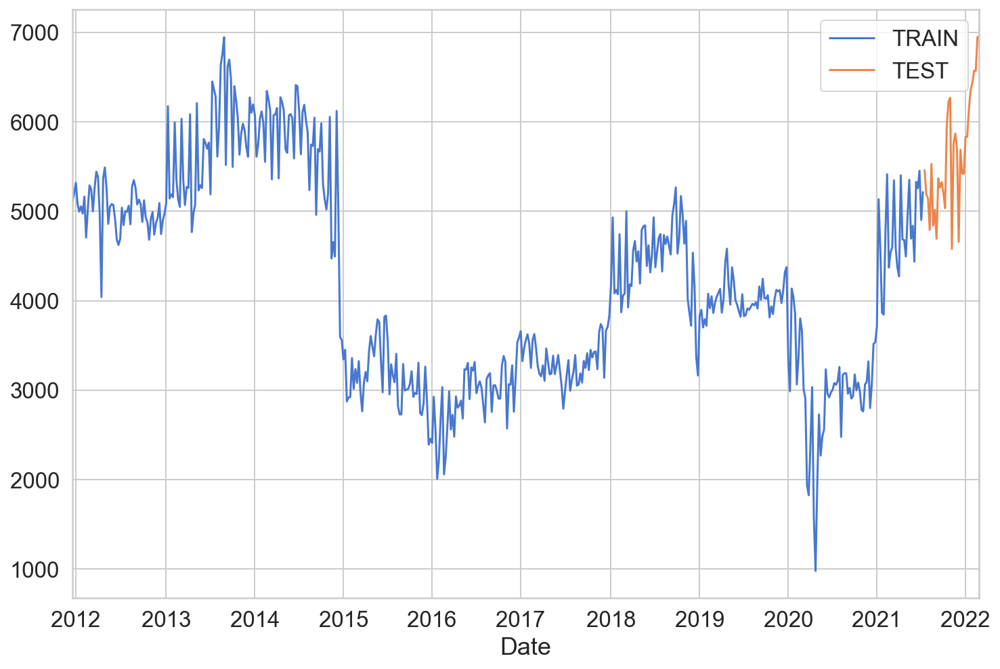

In [270]:
train_data['Price'].plot(legend=True,label='TRAIN')
test_data['Price'].plot(legend=True,label='TEST',figsize=(12,8))

<AxesSubplot:xlabel='Date'>

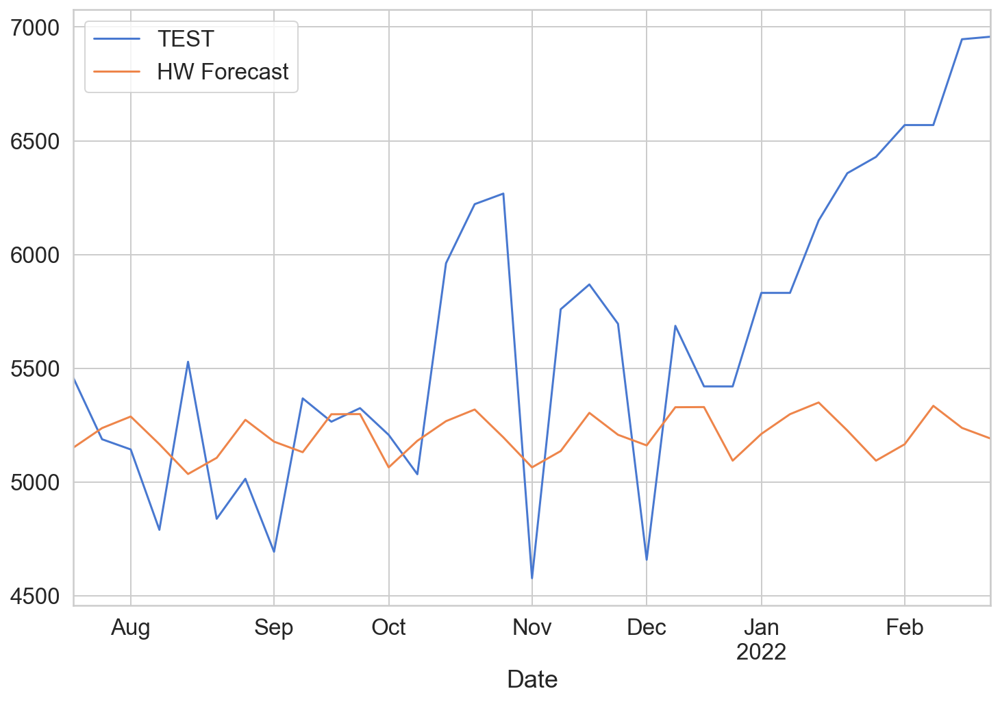

In [271]:
test_data['Price'].plot(legend=True,label='TEST',figsize=(12,8))
test_predictions.plot(legend=True)

<AxesSubplot:>

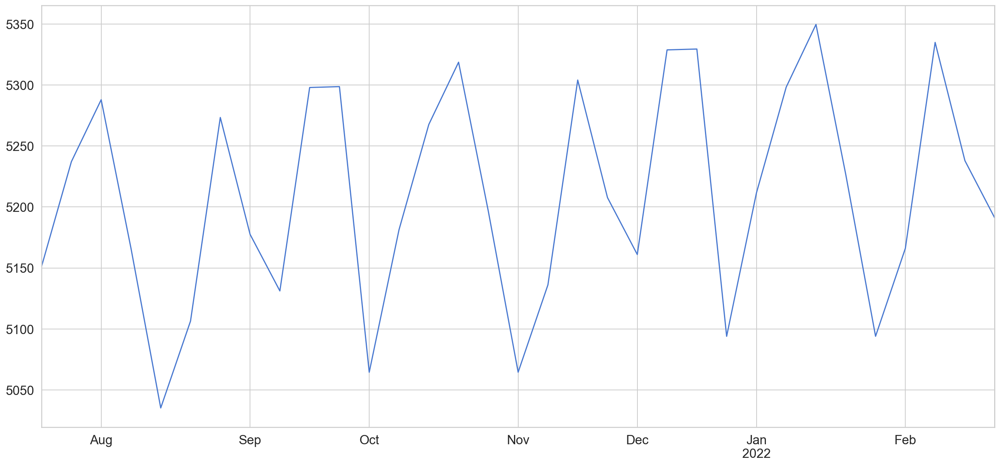

In [272]:
test_predictions.plot()

<AxesSubplot:xlabel='Date'>

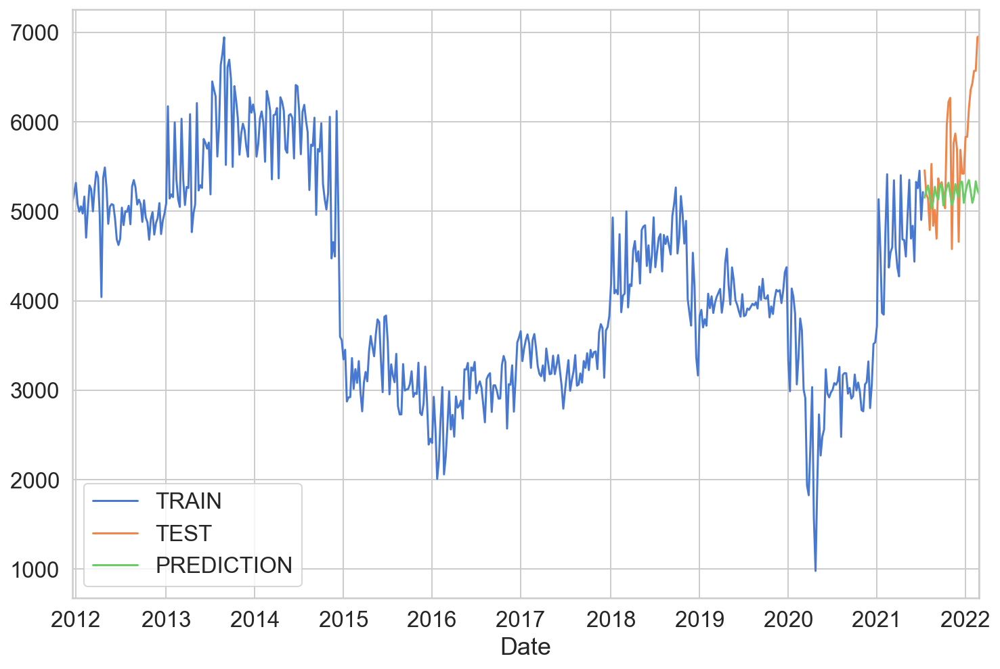

In [273]:
train_data['Price'].plot(legend=True,label='TRAIN')
test_data['Price'].plot(legend=True,label='TEST',figsize=(12,8))
test_predictions.plot(legend=True,label='PREDICTION')

In [274]:
from statsmodels.tools.eval_measures import rmse

error = rmse(test_data['Price'], test_predictions)
print(f'RMSE Error: {error:11.10}')

RMSE Error: 758.7116377


Stationarity or Not

In [275]:
import warnings
warnings.filterwarnings("ignore")

In [276]:

from statsmodels.tsa.stattools import acovf,acf,pacf,pacf_yw,pacf_ols

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


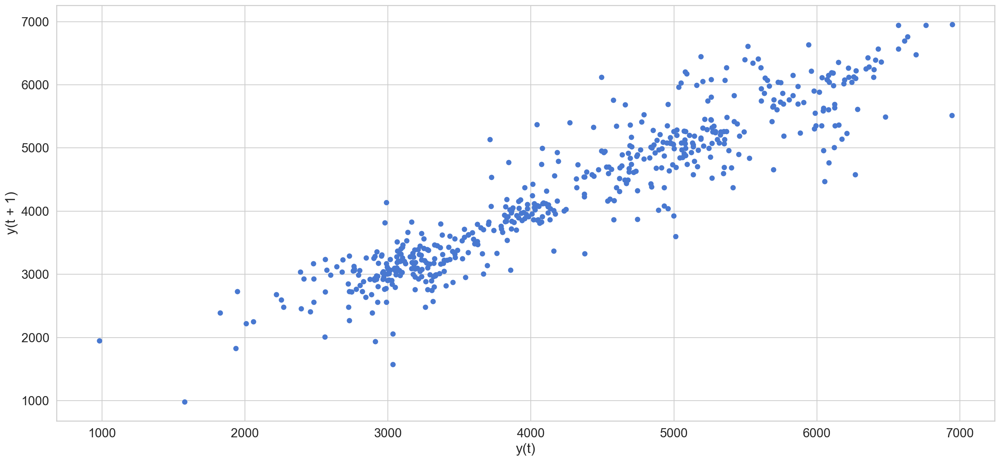

In [277]:
from pandas.plotting import lag_plot

lag_plot(df3['Price']);

In [106]:
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf

In [107]:
acf(df3['Price']).shape


(28,)

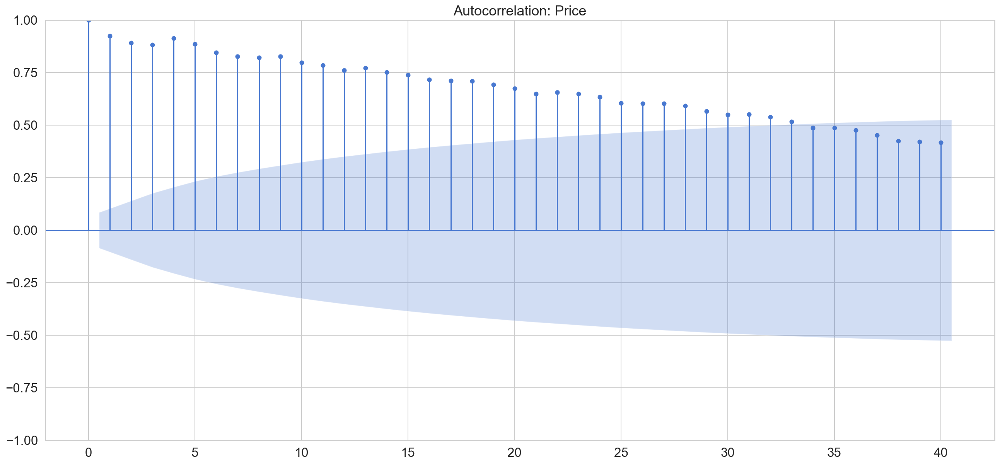

In [108]:

title = 'Autocorrelation: Price'
lags = 40
plot_acf(df3['Price'],title=title,lags=lags);

This plot indicates non-stationary data, as there are a large number of lags before ACF values drop off.

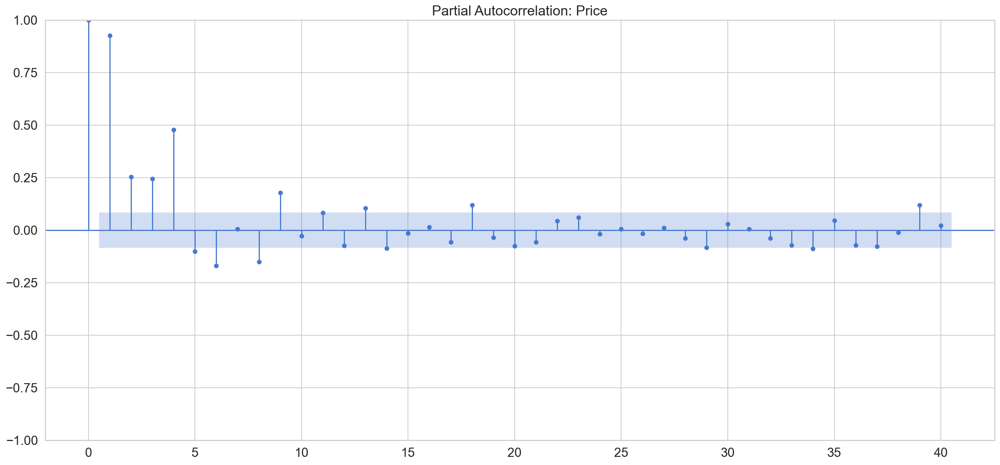

In [109]:
title='Partial Autocorrelation: Price'
lags=40
plot_pacf(df3['Price'],title=title,lags=lags);

# AR(p) AutoRegressive Model

In [110]:
from statsmodels.tsa.ar_model import AR,ARResults,AutoReg

In [111]:
train = df.iloc[:500]
test = df.iloc[500:]

# Fitting AR(1) Model

In [282]:
model = AutoReg(train['Price'],lags=1)
AR1fit = model.fit()


In [283]:

start=len(train)
end=len(train)+len(test)-1
predictions1 = AR1fit.predict(start=start, end=end, dynamic=False).rename('AR(1) Predictions')

In [284]:
predictions1

2438    0.360253
2439    0.358134
2440    0.356023
2441    0.353920
2442    0.351826
2443    0.349740
2444    0.347661
2445    0.345591
2446    0.343529
2447    0.341475
2448    0.339428
2449    0.337390
2450    0.335359
2451    0.333336
2452    0.331322
2453    0.329314
2454    0.327315
2455    0.325323
2456    0.323339
2457    0.321363
2458    0.319394
2459    0.317433
2460    0.315480
2461    0.313534
2462    0.311595
2463    0.309665
2464    0.307741
2465    0.305825
2466    0.303916
2467    0.302015
2468    0.300121
2469    0.298234
2470    0.296355
2471    0.294483
2472    0.292618
2473    0.290761
2474    0.288910
2475    0.287067
2476    0.285230
2477    0.283401
2478    0.281579
2479    0.279764
2480    0.277956
2481    0.276155
2482    0.274361
2483    0.272574
2484    0.270794
2485    0.269020
2486    0.267254
2487    0.265494
2488    0.263741
2489    0.261995
2490    0.260256
2491    0.258523
2492    0.256797
2493    0.255078
2494    0.253365
2495    0.251659
2496    0.2499

Fit an AR(p) model where statsmodels chooses p

In [285]:
ARfit = model.fit()

print(f'Coefficients:\n{ARfit.params}')

Coefficients:
const      -0.000727
Price.L1    0.996138
dtype: float64


In [286]:
start = len(train)
end = len(train)+len(test)-1
rename = f'AR(11) Predictions'

predictions11 = ARfit.predict(start=start,end=end,dynamic=False).rename(rename)

In [287]:
from sklearn.metrics import mean_squared_error

labels = ['AR(1)','AR(11)']
preds = [predictions1,  predictions11]  # these are variables, not strings!

for i in range(2):
    error = mean_squared_error(test['Price'], preds[i])
    print(f'{labels[i]} Error: {error:11.10}')

AR(1) Error: 0.424256674
AR(11) Error: 0.424256674


# Augmented Dickey-Fuller Test

In [118]:
from statsmodels.tsa.stattools import ccovf,ccf
from statsmodels.tsa.stattools import adfuller,kpss,coint,bds,q_stat,grangercausalitytests,levinson_durbin
from statsmodels.tools.eval_measures import mse, rmse, meanabs


In [119]:
from statsmodels.tsa.stattools import adfuller

def adf_test(series,title=''):
    """
    Pass in a time series and an optional title, returns an ADF report
    """
    print(f'Augmented Dickey-Fuller Test: {title}')
    result = adfuller(series.dropna(),autolag='AIC') # .dropna() handles differenced data
    
    labels = ['ADF test statistic','p-value','# lags used','# observations']
    out = pd.Series(result[0:4],index=labels)

    for key,val in result[4].items():
        out[f'critical value ({key})']=val
        
    print(out.to_string())          # .to_string() removes the line "dtype: float64"
    
    if result[1] <= 0.05:
        print("Strong evidence against the null hypothesis")
        print("Reject the null hypothesis")
        print("Data has no unit root and is stationary")
    else:
        print("Weak evidence against the null hypothesis")
        print("Fail to reject the null hypothesis")
        print("Data has a unit root and is non-stationary")

In [120]:
adf_test(df3['Price'])

Augmented Dickey-Fuller Test: 
ADF test statistic     -0.895398  
p-value                 0.789484  
# lags used             17.000000 
# observations          515.000000
critical value (1%)    -3.443112  
critical value (5%)    -2.867168  
critical value (10%)   -2.569768  
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary


# ARIMA

In [121]:
from pmdarima import auto_arima

import warnings
warnings.filterwarnings("ignore")

In [122]:
df3

,Price,Open,High,Low,Volume
Date,,,,,
2011-12-18,5107.166667,5143.166667,5189.833333,5059.500000,183930.000000
2011-12-25,5201.166667,5153.000000,5216.333333,5134.000000,139528.333333
2012-01-01,5317.500000,5311.166667,5347.333333,5273.166667,102036.666667
2012-01-08,5081.400000,5099.400000,5160.400000,5024.000000,194426.000000
2012-01-15,4995.000000,5018.666667,5040.333333,4976.666667,110241.666667
2012-01-22,5055.000000,5089.333333,5112.166667,5031.000000,124381.666667
2012-01-29,4974.800000,4984.600000,5003.200000,4938.600000,135002.000000
2012-02-05,5164.142857,5178.428571,5221.714286,5128.142857,135901.428571
2012-02-12,4705.250000,4746.250000,4763.250000,4676.250000,204547.500000


In [123]:
len(df3)

533

In [124]:
auto_arima(df3['Price'])

ARIMA(order=(5, 1, 2), scoring_args={}, suppress_warnings=True,
      with_intercept=False)

In [125]:
auto_arima(df3['Price'],error_action='ignore').summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                  533
Model:               SARIMAX(5, 1, 2)   Log Likelihood               -3832.980
Date:                Sat, 05 Mar 2022   AIC                           7681.960
Time:                        01:08:15   BIC                           7716.173
Sample:                             0   HQIC                          7695.350
                                - 533                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.7615      0.118     -6.450      0.000      -0.993      -0.530
ar.L2         -0.0249      0.177     -0.141      0.888      -0.372       0.322
ar.L3         -0.2767      0.112     -2.474      0.013      -0.496      -0.057
ar.L4          0.2472      0.104      2.387      0.017       0.044       0.450
ar.L5          0.4652      0.060      7.731      0.000       0.347       0.583
ma.L1          0.2908      0.128      2.270      0.023       0.040       0.542
ma.L2         -0.4657      0.141     -3.296      0.001      -0.743      -0.189
sigma2      1.053e+05   4051.333     25.980      0.000    9.73e+04    1.13e+05
===================================================================================
Ljung-Box (L1) (Q):                   0.03   Jarque-Bera (JB):               315.78
Prob(Q):                              0.86   Prob(JB):                         0.00
Heteroskedasticity (H):               1.13   Skew:                            -0.17
Prob(H) (two-sided):                  0.41   Kurtosis:                         6.76
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [126]:
stepwise_fit = auto_arima(df3['Price'], start_p=1, start_q=1,
                          max_p=3, max_q=3, m=12,
                          start_P=0, seasonal=True,
                          d=None, D=1, trace=True,
                          error_action='ignore',   # we don't want to know if an order does not work
                          suppress_warnings=True,  # we don't want convergence warnings
                          stepwise=True)           # set to stepwise

stepwise_fit.summary()

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=2.04 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=8376.870, Time=0.03 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=7968.093, Time=0.99 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=8190.221, Time=0.73 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=8375.452, Time=0.02 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=8176.814, Time=0.10 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=7891.066, Time=3.20 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=inf, Time=6.00 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=7834.519, Time=2.36 sec
 ARIMA(1,0,0)(0,1,1)[12] intercept   : AIC=inf, Time=1.23 sec
 ARIMA(1,0,0)(1,1,2)[12] intercept   : AIC=7838.462, Time=5.99 sec
 ARIMA(1,0,0)(0,1,2)[12] intercept   : AIC=7840.511, Time=5.03 sec
 ARIMA(1,0,0)(2,1,2)[12] intercept   : AIC=inf, Time=6.00 sec
 ARIMA(0,0,0)(1,1,1)[12] intercept   : AIC=8357.348, Time=0.46 sec
 ARIMA(2,0,0)(1,1,1)[12] intercept   : 

<class 'statsmodels.iolib.summary.Summary'>
"""
                                      SARIMAX Results                                       
============================================================================================
Dep. Variable:                                    y   No. Observations:                  533
Model:             SARIMAX(2, 0, 0)x(1, 1, [1], 12)   Log Likelihood               -3896.472
Date:                              Sat, 05 Mar 2022   AIC                           7804.944
Time:                                      01:09:45   BIC                           7830.478
Sample:                                           0   HQIC                          7814.946
                                              - 533                                         
Covariance Type:                                opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      1.3496      2.840      0.475      0.635      -4.216       6.915
ar.L1          0.7289      0.035     20.653      0.000       0.660       0.798
ar.L2          0.2268      0.035      6.496      0.000       0.158       0.295
ar.S.L12      -0.3104      0.041     -7.557      0.000      -0.391      -0.230
ma.S.L12      -0.8599      0.035    -24.544      0.000      -0.929      -0.791
sigma2      1.686e+05   7987.154     21.109      0.000    1.53e+05    1.84e+05
===================================================================================
Ljung-Box (L1) (Q):                   1.68   Jarque-Bera (JB):                44.73
Prob(Q):                              0.20   Prob(JB):                         0.00
Heteroskedasticity (H):               0.89   Skew:                            -0.10
Prob(H) (two-sided):                  0.45   Kurtosis:                         4.42
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [127]:
from statsmodels.tsa.statespace.tools import diff
df3['d1'] = diff(df3['Price'],k_diff=1)
adf_test(df3['d1'],'Diff Price 1')

Augmented Dickey-Fuller Test: Diff Price 1
ADF test statistic     -6.116961e+00
p-value                 9.045948e-08
# lags used             1.600000e+01
# observations          5.150000e+02
critical value (1%)    -3.443112e+00
critical value (5%)    -2.867168e+00
critical value (10%)   -2.569768e+00
Strong evidence against the null hypothesis
Reject the null hypothesis
Data has no unit root and is stationary


This confirms that we reached stationarity after the first difference.

In [128]:
len(df3)

533

In [129]:
train = df3.iloc[:500]
test = df3.iloc[500:]

In [130]:
import statsmodels.api as sm

In [131]:
results = sm.tsa.statespace.SARIMAX(train['Price'],order=(5,1,12),
                                enforce_stationarity=False, enforce_invertibility=False).fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                  Price   No. Observations:                  500
Model:              SARIMAX(5, 1, 12)   Log Likelihood               -3480.051
Date:                Sat, 05 Mar 2022   AIC                           6996.102
Time:                        01:09:48   BIC                           7071.453
Sample:                    12-18-2011   HQIC                          7025.705
                         - 07-11-2021                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.1764      1.284     -0.916      0.360      -3.693       1.340
ar.L2         -0.9363      1.720     -0.544      0.586      -4.307       2.434
ar.L3         -1.1325      1.520     -0.745      0.456      -4.111       1.846
ar.L4         -0.5277      1.722     -0.306      0.759      -3.904       2.848
ar.L5          0.1590      0.990      0.161      0.872      -1.782       2.100
ma.L1          0.7385      1.289      0.573      0.567      -1.788       3.265
ma.L2          0.2324      1.160      0.200      0.841      -2.041       2.506
ma.L3          0.3802      0.531      0.716      0.474      -0.660       1.420
ma.L4          0.2845      0.586      0.485      0.628      -0.865       1.434
ma.L5         -0.1171      0.474     -0.247      0.805      -1.046       0.812
ma.L6          0.1127      0.099      1.142      0.254      -0.081       0.306
ma.L7          0.2612      0.138      1.889      0.059      -0.010       0.532
ma.L8          0.0679      0.356      0.191      0.849      -0.629       0.765
ma.L9         -0.1803      0.158     -1.139      0.255      -0.490       0.130
ma.L10         0.0161      0.226      0.071      0.943      -0.427       0.459
ma.L11         0.2269      0.066      3.428      0.001       0.097       0.357
ma.L12         0.0005      0.262      0.002      0.998      -0.513       0.514
sigma2      1.012e+05   4634.257     21.843      0.000    9.21e+04     1.1e+05
===================================================================================
Ljung-Box (L1) (Q):                   0.00   Jarque-Bera (JB):               368.04
Prob(Q):                              0.99   Prob(JB):                         0.00
Heteroskedasticity (H):               1.01   Skew:                            -0.03
Prob(H) (two-sided):                  0.97   Kurtosis:                         7.26
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [132]:
# Obtain predicted values
start=len(train)
end=len(train)+len(test)-1
predictions = results.predict(start=start, end=end, dynamic=False, typ='levels').rename('SARIMA Predictions')

<AxesSubplot:xlabel='Date'>

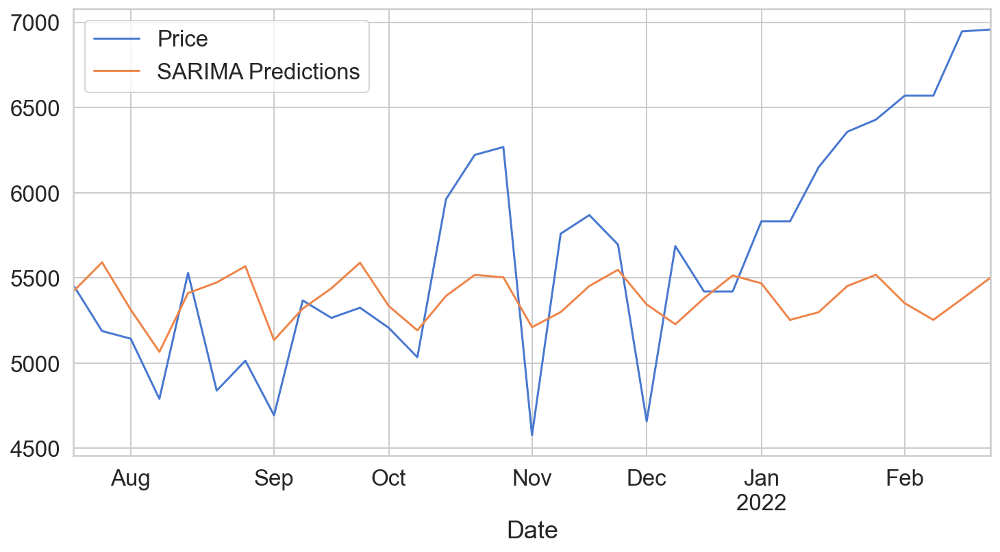

In [133]:
test['Price'].plot(legend=True,figsize=(12,6))
predictions.plot(legend=True)

In [134]:
from sklearn.metrics import mean_squared_error

error = mean_squared_error(test['Price'], predictions)

In [135]:
error = np.sqrt(error)
print(error)

671.2105548504339


In [291]:
df=df.sort_index()

In [292]:
df

,Price,Open,High,Low,Volume,year,day_of_month,day_of_week,month,6-month-SMA,12-month-SMA,EWMA12,TESadd12,TESmul12
Date,,,,,,,,,,,,,,
2011-12-12,5203,5180,5222,5161,220040,2011,12,1,12,5107.166667,5154.166667,5173.696283,5224.994773,5230.507849
2011-12-13,5342,5206,5380,5206,214520,2011,13,1,12,5070.500000,5161.333333,5168.368335,5095.835373,5101.595503
2011-12-14,5209,5353,5368,5186,243960,2011,14,1,12,5039.000000,5164.000000,5136.798941,4994.029141,4998.881444
2011-12-15,5036,5200,5200,5021,225330,2011,15,1,12,5039.833333,5173.666667,5123.671476,4938.446422,4941.609671
2011-12-16,4903,5014,5014,4877,193310,2011,16,1,12,5078.500000,5196.000000,5139.611744,5003.020120,5002.445022
2011-12-17,4950,4906,4955,4906,6420,2011,17,5,12,5144.666667,5230.500000,5182.632062,5091.420981,5082.217171
2011-12-19,4983,4942,5003,4911,136760,2011,19,1,12,5201.166667,5259.333333,5224.928800,5235.095669,5221.189394
2011-12-20,5153,5024,5170,5012,202070,2011,20,1,12,5252.166667,5287.833333,5268.915855,5372.422153,5421.628419
2011-12-21,5214,5160,5242,5125,243000,2011,21,1,12,5289.000000,5311.916667,5289.991464,5154.546731,5185.667410


In [293]:
df=df.asfreq('d').ffill()

In [301]:
df.index

DatetimeIndex(['2011-12-12', '2011-12-13', '2011-12-14', '2011-12-15',
               '2011-12-16', '2011-12-17', '2011-12-18', '2011-12-19',
               '2011-12-20', '2011-12-21',
               ...
               '2022-11-22', '2022-11-23', '2022-11-24', '2022-11-25',
               '2022-11-26', '2022-11-27', '2022-11-28', '2022-11-29',
               '2022-11-30', '2022-12-01'],
              dtype='datetime64[ns]', name='Date', length=4008, freq='D')

In [302]:
len(df)

4008

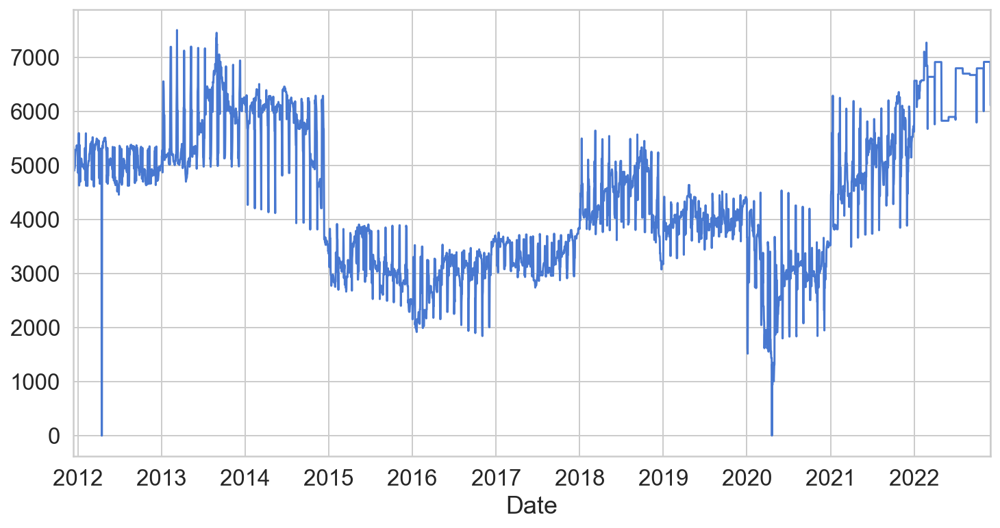

In [303]:
ax = df['Price'].plot(figsize=(12,6))
ax.autoscale(axis='x',tight=True)

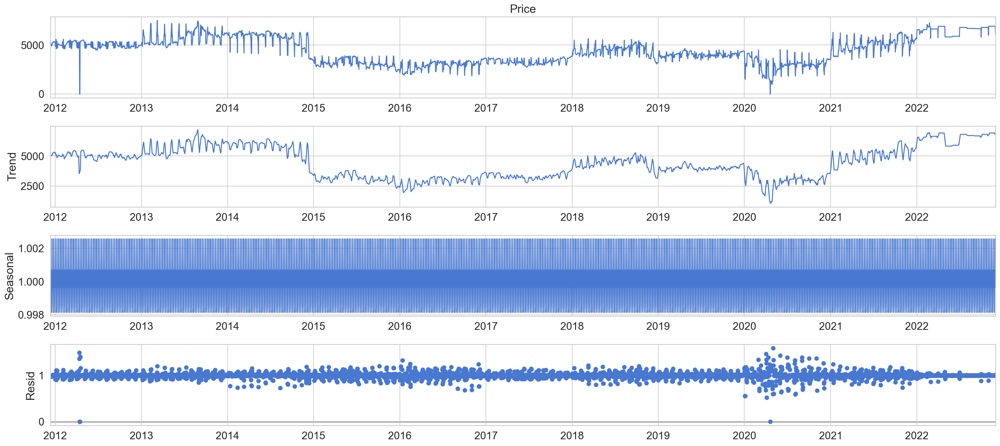

In [304]:
result = seasonal_decompose(df['Price'], model='mul')
result.plot();

In [305]:
df

,Price,Open,High,Low,Volume,year,day_of_month,day_of_week,month,6-month-SMA,12-month-SMA,EWMA12,TESadd12,TESmul12
Date,,,,,,,,,,,,,,
2011-12-12,5203.0,5180.0,5222.0,5161.0,220040.0,2011.0,12.0,1.0,12.0,5107.166667,5154.166667,5173.696283,5224.994773,5230.507849
2011-12-13,5342.0,5206.0,5380.0,5206.0,214520.0,2011.0,13.0,1.0,12.0,5070.500000,5161.333333,5168.368335,5095.835373,5101.595503
2011-12-14,5209.0,5353.0,5368.0,5186.0,243960.0,2011.0,14.0,1.0,12.0,5039.000000,5164.000000,5136.798941,4994.029141,4998.881444
2011-12-15,5036.0,5200.0,5200.0,5021.0,225330.0,2011.0,15.0,1.0,12.0,5039.833333,5173.666667,5123.671476,4938.446422,4941.609671
2011-12-16,4903.0,5014.0,5014.0,4877.0,193310.0,2011.0,16.0,1.0,12.0,5078.500000,5196.000000,5139.611744,5003.020120,5002.445022
2011-12-17,4950.0,4906.0,4955.0,4906.0,6420.0,2011.0,17.0,5.0,12.0,5144.666667,5230.500000,5182.632062,5091.420981,5082.217171
2011-12-18,4950.0,4906.0,4955.0,4906.0,6420.0,2011.0,17.0,5.0,12.0,5144.666667,5230.500000,5182.632062,5091.420981,5082.217171
2011-12-19,4983.0,4942.0,5003.0,4911.0,136760.0,2011.0,19.0,1.0,12.0,5201.166667,5259.333333,5224.928800,5235.095669,5221.189394
2011-12-20,5153.0,5024.0,5170.0,5012.0,202070.0,2011.0,20.0,1.0,12.0,5252.166667,5287.833333,5268.915855,5372.422153,5421.628419


In [306]:
len(df)

4008

In [307]:
df.index

DatetimeIndex(['2011-12-12', '2011-12-13', '2011-12-14', '2011-12-15',
               '2011-12-16', '2011-12-17', '2011-12-18', '2011-12-19',
               '2011-12-20', '2011-12-21',
               ...
               '2022-11-22', '2022-11-23', '2022-11-24', '2022-11-25',
               '2022-11-26', '2022-11-27', '2022-11-28', '2022-11-29',
               '2022-11-30', '2022-12-01'],
              dtype='datetime64[ns]', name='Date', length=4008, freq='D')

In [308]:
df4=df.asfreq('MS')

In [309]:
df4

,Price,Open,High,Low,Volume,year,day_of_month,day_of_week,month,6-month-SMA,12-month-SMA,EWMA12,TESadd12,TESmul12
Date,,,,,,,,,,,,,,
2012-01-01,5296.0,5310.0,5310.0,5293.0,3610.0,2011.0,31.0,5.0,12.0,5385.500000,5326.583333,5309.230752,5396.140112,5385.819817
2012-02-01,5325.0,5293.0,5329.0,5282.0,20450.0,2012.0,1.0,1.0,1.0,5397.166667,5310.666667,5311.636344,5486.519943,5471.741740
2012-03-01,5442.0,5332.0,5464.0,5332.0,213000.0,2012.0,1.0,1.0,1.0,5392.166667,5294.333333,5309.206588,5566.886069,5623.956505
2012-04-01,5462.0,5457.0,5498.0,5413.0,227480.0,2012.0,1.0,6.0,1.0,5371.500000,5266.416667,5285.062331,5261.384348,5293.633300
2012-05-01,5443.0,5451.0,5465.0,5402.0,203700.0,2012.0,1.0,1.0,5.0,5342.000000,5233.083333,5252.891846,5342.635430,5353.441355
2012-06-01,5345.0,5436.0,5436.0,5325.0,212280.0,2012.0,1.0,1.0,6.0,5311.500000,5200.083333,5218.326727,5346.445585,5356.327838
2012-07-01,5366.0,5358.0,5379.0,5358.0,5860.0,2012.0,1.0,6.0,7.0,5267.666667,5171.833333,5195.295223,5296.946550,5305.530232
2012-08-01,4921.0,4985.0,5025.0,4907.0,257800.0,2012.0,31.0,1.0,7.0,5011.000000,5082.416667,5075.526811,4989.423241,4993.094303
2012-09-01,5295.0,5355.0,5370.0,5275.0,210370.0,2012.0,1.0,5.0,9.0,5224.166667,5139.583333,5164.257991,5294.406043,5299.952128


In [310]:
len(df4)

132

<AxesSubplot:xlabel='Date'>

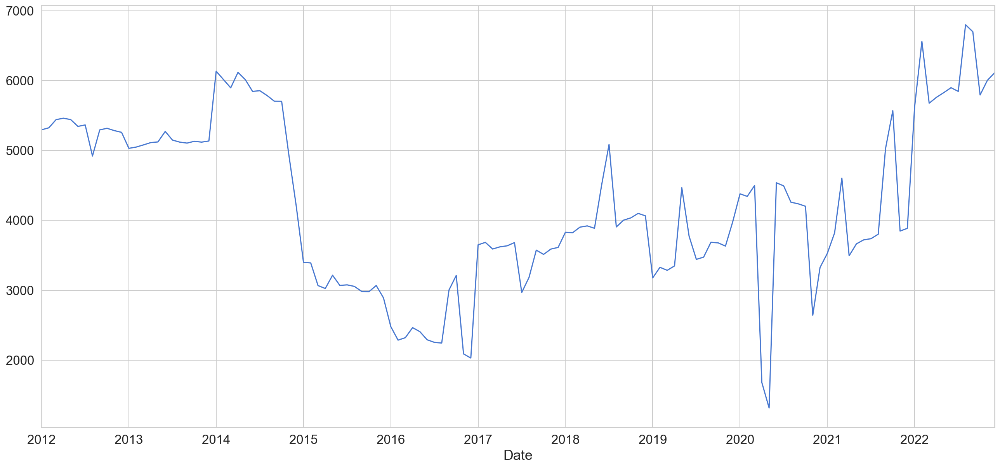

In [311]:
df4['Price'].plot()

In [166]:
df4

,Price,Open,High,Low,Volume,year,day_of_month,day_of_week,month,6-month-SMA,12-month-SMA,EWMA12,TESadd12,TESmul12
Date,,,,,,,,,,,,,,
2012-01-01,5296.0,5310.0,5310.0,5293.0,3610.0,2011.0,31.0,5.0,12.0,5385.500000,5326.583333,5309.230752,5396.140112,5385.819817
2012-02-01,5325.0,5293.0,5329.0,5282.0,20450.0,2012.0,1.0,1.0,1.0,5397.166667,5310.666667,5311.636344,5486.519943,5471.741740
2012-03-01,5442.0,5332.0,5464.0,5332.0,213000.0,2012.0,1.0,1.0,1.0,5392.166667,5294.333333,5309.206588,5566.886069,5623.956505
2012-04-01,5462.0,5457.0,5498.0,5413.0,227480.0,2012.0,1.0,6.0,1.0,5371.500000,5266.416667,5285.062331,5261.384348,5293.633300
2012-05-01,5443.0,5451.0,5465.0,5402.0,203700.0,2012.0,1.0,1.0,5.0,5342.000000,5233.083333,5252.891846,5342.635430,5353.441355
2012-06-01,5345.0,5436.0,5436.0,5325.0,212280.0,2012.0,1.0,1.0,6.0,5311.500000,5200.083333,5218.326727,5346.445585,5356.327838
2012-07-01,5366.0,5358.0,5379.0,5358.0,5860.0,2012.0,1.0,6.0,7.0,5267.666667,5171.833333,5195.295223,5296.946550,5305.530232
2012-08-01,4921.0,4985.0,5025.0,4907.0,257800.0,2012.0,31.0,1.0,7.0,5011.000000,5082.416667,5075.526811,4989.423241,4993.094303
2012-09-01,5295.0,5355.0,5370.0,5275.0,210370.0,2012.0,1.0,5.0,9.0,5224.166667,5139.583333,5164.257991,5294.406043,5299.952128


In [167]:
df4=df4.drop(columns=['year', 'day_of_month',
       'day_of_week', 'month', '6-month-SMA', '12-month-SMA', 'EWMA12',
       'TESadd12', 'TESmul12'])

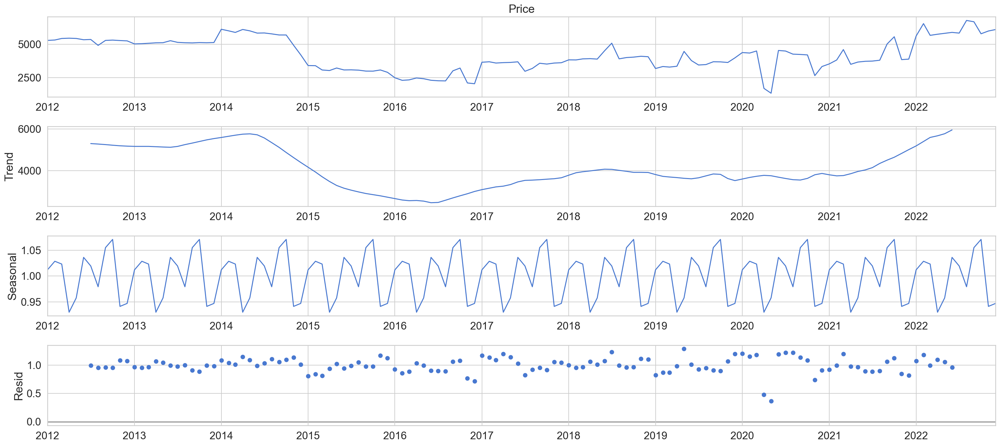

In [168]:
result = seasonal_decompose(df4['Price'], model='mul')
result.plot();

In [169]:
train = df4.iloc[:125]
test = df4.iloc[125:]

In [170]:
stepwise_fit = auto_arima(df4['Price'], start_p=0, start_q=0,
                          max_p=2, max_q=2, m=7,
                          start_P=0, seasonal=True,
                          d=None, D=1, trace=True,
                          error_action='ignore',   # we don't want to know if an order does not work
                          suppress_warnings=True,  # we don't want convergence warnings
                          stepwise=False)           # set to stepwise

stepwise_fit.summary()

 ARIMA(0,1,0)(0,1,0)[7]             : AIC=2010.352, Time=0.05 sec
 ARIMA(0,1,0)(0,1,1)[7]             : AIC=inf, Time=0.13 sec
 ARIMA(0,1,0)(0,1,2)[7]             : AIC=inf, Time=0.24 sec
 ARIMA(0,1,0)(1,1,0)[7]             : AIC=1991.702, Time=0.17 sec
 ARIMA(0,1,0)(1,1,1)[7]             : AIC=inf, Time=0.19 sec
 ARIMA(0,1,0)(1,1,2)[7]             : AIC=inf, Time=0.83 sec
 ARIMA(0,1,0)(2,1,0)[7]             : AIC=1989.062, Time=0.14 sec
 ARIMA(0,1,0)(2,1,1)[7]             : AIC=inf, Time=0.35 sec
 ARIMA(0,1,0)(2,1,2)[7]             : AIC=inf, Time=0.49 sec
 ARIMA(0,1,1)(0,1,0)[7]             : AIC=2008.858, Time=0.05 sec
 ARIMA(0,1,1)(0,1,1)[7]             : AIC=inf, Time=0.16 sec
 ARIMA(0,1,1)(0,1,2)[7]             : AIC=inf, Time=0.35 sec
 ARIMA(0,1,1)(1,1,0)[7]             : AIC=1987.612, Time=0.15 sec
 ARIMA(0,1,1)(1,1,1)[7]             : AIC=inf, Time=0.28 sec
 ARIMA(0,1,1)(1,1,2)[7]             : AIC=inf, Time=0.81 sec
 ARIMA(0,1,1)(2,1,0)[7]             : AIC=1987.240, Time=0.2

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                      
==========================================================================================
Dep. Variable:                                  y   No. Observations:                  132
Model:             SARIMAX(0, 1, 2)x(2, 1, [], 7)   Log Likelihood                -977.435
Date:                            Sat, 05 Mar 2022   AIC                           1964.870
Time:                                    01:30:40   BIC                           1978.972
Sample:                                         0   HQIC                          1970.599
                                            - 132                                         
Covariance Type:                              opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.0602      0.085     -0.709      0.478      -0.227       0.106
ma.L2         -0.4583      0.064     -7.186      0.000      -0.583      -0.333
ar.S.L7       -0.4213      0.078     -5.372      0.000      -0.575      -0.268
ar.S.L14      -0.1796      0.074     -2.430      0.015      -0.324      -0.035
sigma2      4.019e+05   3.41e+04     11.793      0.000    3.35e+05    4.69e+05
===================================================================================
Ljung-Box (L1) (Q):                   0.13   Jarque-Bera (JB):               101.96
Prob(Q):                              0.71   Prob(JB):                         0.00
Heteroskedasticity (H):               4.16   Skew:                            -0.33
Prob(H) (two-sided):                  0.00   Kurtosis:                         7.39
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [171]:
model = sm.tsa.statespace.SARIMAX(train['Price'],order=(0,1,2),seasonal_order=(2,1,0,7))
results = model.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                      
==========================================================================================
Dep. Variable:                              Price   No. Observations:                  125
Model:             SARIMAX(0, 1, 2)x(2, 1, [], 7)   Log Likelihood                -921.569
Date:                            Sat, 05 Mar 2022   AIC                           1853.138
Time:                                    01:30:40   BIC                           1866.949
Sample:                                01-01-2012   HQIC                          1858.745
                                     - 05-01-2022                                         
Covariance Type:                              opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.0146      0.085     -0.172      0.863      -0.180       0.151
ma.L2         -0.4993      0.064     -7.751      0.000      -0.626      -0.373
ar.S.L7       -0.4349      0.082     -5.279      0.000      -0.596      -0.273
ar.S.L14      -0.1909      0.076     -2.500      0.012      -0.341      -0.041
sigma2      3.949e+05   3.32e+04     11.884      0.000     3.3e+05     4.6e+05
===================================================================================
Ljung-Box (L1) (Q):                   0.19   Jarque-Bera (JB):               129.04
Prob(Q):                              0.66   Prob(JB):                         0.00
Heteroskedasticity (H):               3.92   Skew:                            -0.50
Prob(H) (two-sided):                  0.00   Kurtosis:                         8.05
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [172]:

start=len(train)
end=len(train)+len(test)-1
predictions = results.predict(start=start, end=end, dynamic=False, typ='levels').rename('SARIMA Predictions')

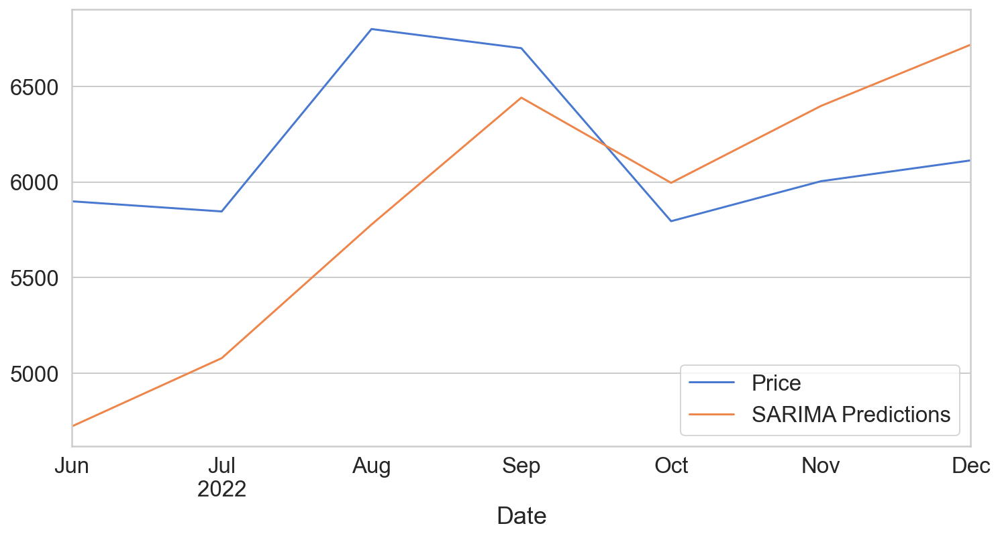

In [173]:
ax = test['Price'].plot(legend=True,figsize=(12,6))
predictions.plot(legend=True)
ax.autoscale(axis='x',tight=True)

In [174]:
from statsmodels.tools.eval_measures import rmse

error = rmse(test['Price'], predictions)
print(f'RMSE Error: {error:11.10}')

RMSE Error:  721.883761


In [175]:
model = sm.tsa.statespace.SARIMAX(df4['Price'],order=(0,1,2),seasonal_order=(2,1,0,7))
results = model.fit()
fcast = results.predict(len(df4),len(df4)+7,typ='levels').rename('Forecast')

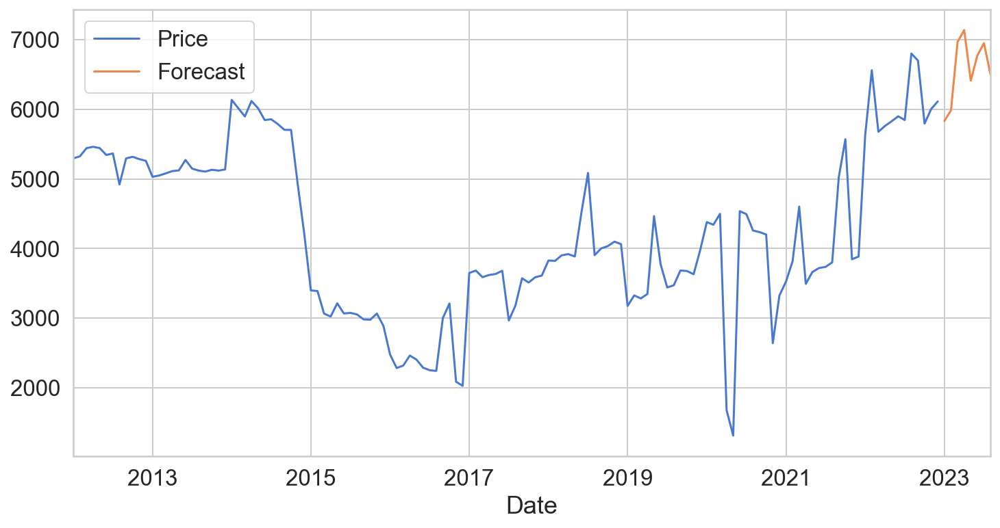

In [176]:
ax = df4['Price'].plot(legend=True,figsize=(12,6))
fcast.plot(legend=True)
ax.autoscale(axis='x',tight=True)